In [ ]:
# Iman Wahle
# March 11 2021

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
import compare
import warnings
from tensorflow.keras.datasets import mnist
from sklearn.manifold import TSNE

In [2]:
# paths
base_path = '/Users/imanwahle/Desktop/cfl/cfl/cluster_methods/compare_methods'
DATA_PATH = os.path.join(base_path, 'data')
RESULTS_PATH = os.path.join(base_path, 'results')
FIG_PATH = os.path.join(base_path, 'figures')

In [8]:
# this is the most important section to talk about 

# already: have a bunch of datasets saved in the right format 

# setup arguments for comparison

# list of all data sets you want to use 
# names correspond with folder names 
data_path_list = ['vb_noise0.0', 'vb_noise0.1']

# specify all the methods from sklearn you want to use 
method_list = ['SpectralClustering', 'AgglomerativeClustering', 'DBSCAN', 'KMeans']

# each entry in params corresponds to an entry in method list 
params = [  {'n_clusters' : (2,6,4)},  # (2, 6, 4) is in np linspace format - check 2-6, 4 diff values 
            {'n_clusters' : (2,6,4)},
            {'eps' : (0.1, 2.0, 10), 'min_samples' : (1,6,5)}, #can specify multiple arguments to grid search over 
            {'n_clusters' : (2,6,4)}
        ]


# make sure that the type of the things you put in is the right thing (float vs int) or else sklearn will get mad

In [3]:
# run comparison

# for every dataset in dataset list, method in cluster methods, range of params in params --- does the comparison 
with warnings.catch_warnings(): # warnings from CFL make things messy right now
    warnings.simplefilter("ignore")
    compare.main(DATA_PATH, data_path_list, method_list, params, RESULTS_PATH)

# print out: 
# for each combo of method and dataset - shows ground truth clustering vs predicted clustering + the scores 
# this is more to make sure the things are running properly 
# if data is 2d - comp 1, 2 is just the data 
# components are generated by t-SNE 
# (for visual bars - comp 1 is 1-comp2 ) - iman is adding in a histogram feature

# AMI = best ground truth score as recommended by deep clustering paper 
# and silhouette score for extrinsic 
# higher value is better^ for both of these 
# if you switch for something where lower value is better, would need to change logic to choose lowest score 

# and then prints out best parameters

NameError: name 'warnings' is not defined

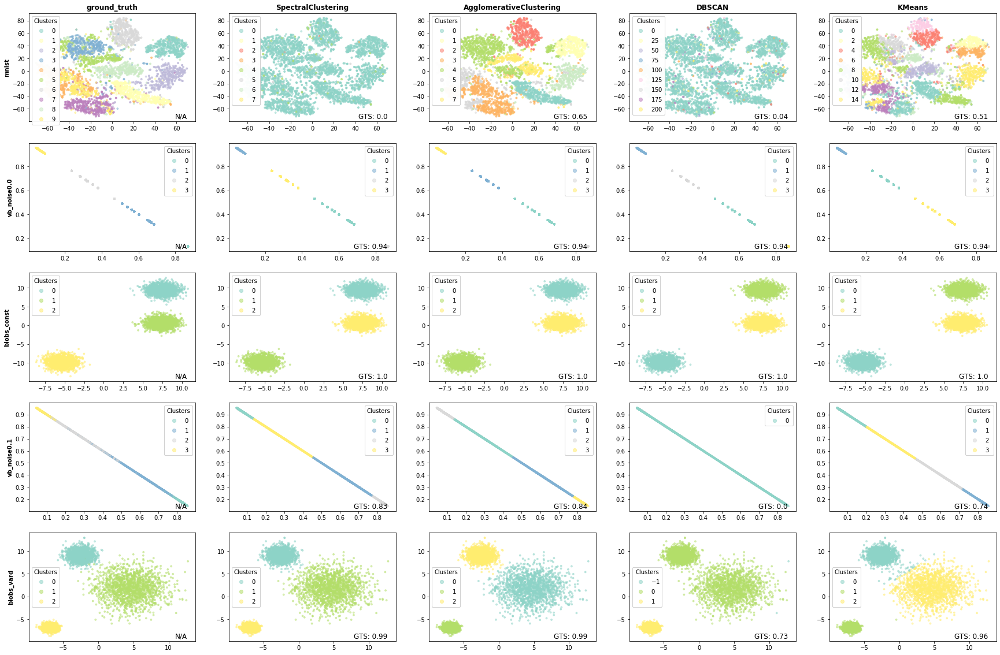

In [14]:
# tell it where you saved your results to, makes scatter plot for everything 
# each row is a data set, each column is a different clustering method 

# combine scatter plots from all datasets
reload(compare)
compare.compare_scatter_plots(DATA_PATH, RESULTS_PATH, subfigsize=(6,4), fig_path=FIG_PATH)

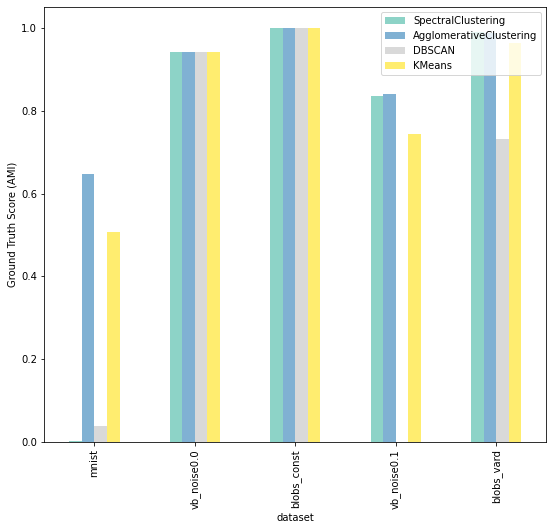

In [12]:
# compares scores of goodness of clustering across all the clustering methods 


# compare ground truth scores from all datasets
compare.compare_best_gt_scores(RESULTS_PATH, fig_path=FIG_PATH)

In [ ]:
# ^ only displays the best parameter combo, but saves all of them, so you can go back and look at them (done by tune_cluster_params())